In [30]:
import warnings
warnings.filterwarnings('ignore')

In [31]:
import pandas as pd
import numpy as np
import re
from plotnine import *

In [91]:
# 자료 불러오기

park = pd.read_csv('park-data.csv', encoding='euc-kr')
park.shape

(13135, 18)

In [92]:
# 어떻게 생긴 데이터지? 인사나 좀 해볼까?

park.head(5)

,관리번호,공원명,공원구분,소재지도로명주소,소재지지번주소,위도,경도,공원면적,공원보유시설(운동시설),공원보유시설(유희시설),공원보유시설(편익시설),공원보유시설(교양시설),공원보유시설(기타시설),지정고시일,관리기관명,전화번호,데이터기준일자,Unnamed: 17
0,42800-00001,상리공원,어린이공원,강원도 양구군 양구읍 상리 531,강원도 양구군 양구읍 상리 531,38.105771,127.985895,1597,NaN,NaN,NaN,NaN,NaN,1995-12-27,강원도 양구군청,033-480-2927,2018-02-28,NaN
1,42800-00002,정림공원1,어린이공원,강원도 양구군 양구읍 상리 587,강원도 양구군 양구읍 상리 587,38.104065,127.984467,1498,NaN,NaN,NaN,NaN,NaN,2009-09-25,강원도 양구군청,033-480-2927,2018-02-28,NaN
2,42800-00003,정림공원2,어린이공원,강원도 양구군 양구읍 상리 604-6,강원도 양구군 양구읍 상리 604-6,38.104065,127.984467,1499,NaN,NaN,NaN,NaN,NaN,2009-09-25,강원도 양구군청,033-480-2927,2018-02-28,NaN
3,42800-00004,하리수변공원,수변공원,강원도 양구군 양구읍 하리 643,강원도 양구군 양구읍 하리 643,38.118243,127.981634,18437,NaN,NaN,NaN,NaN,NaN,2010-03-19,강원도 양구군청,033-480-2460,2018-02-28,NaN
4,42800-00005,묘지공원,묘지공원,강원도 양구군 양구읍 죽곡리 산3-1,강원도 양구군 양구읍 죽곡리 산3-1,38.125344,127.999027,178931,NaN,NaN,NaN,NaN,NaN,2010-10-01,강원도 양구군청,033-480-2576,2018-02-28,NaN


In [93]:
# 자료 형태 확인

park.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13135 entries, 0 to 13134
Data columns (total 18 columns):
관리번호            13135 non-null object
공원명             13135 non-null object
공원구분            13135 non-null object
소재지도로명주소        7237 non-null object
소재지지번주소         11931 non-null object
위도              13129 non-null float64
경도              13129 non-null float64
공원면적            13108 non-null object
공원보유시설(운동시설)    3556 non-null object
공원보유시설(유희시설)    4717 non-null object
공원보유시설(편익시설)    3463 non-null object
공원보유시설(교양시설)    753 non-null object
공원보유시설(기타시설)    2095 non-null object
지정고시일           11196 non-null object
관리기관명           12352 non-null object
전화번호            12210 non-null object
데이터기준일자         13135 non-null object
Unnamed: 17     0 non-null float64
dtypes: float64(3), object(15)
memory usage: 1.8+ MB


In [94]:
# 결측치가 몇개이려나?

park.isnull().sum()

관리번호                0
공원명                 0
공원구분                0
소재지도로명주소         5898
소재지지번주소          1204
위도                  6
경도                  6
공원면적               27
공원보유시설(운동시설)     9579
공원보유시설(유희시설)     8418
공원보유시설(편익시설)     9672
공원보유시설(교양시설)    12382
공원보유시설(기타시설)    11040
지정고시일            1939
관리기관명             783
전화번호              925
데이터기준일자             0
Unnamed: 17     13135
dtype: int64

In [95]:
# 결측치 투성이인 열은 날리고

park.drop(columns=['공원보유시설(운동시설)', '공원보유시설(유희시설)', '공원보유시설(편익시설)', '공원보유시설(교양시설)',
       '공원보유시설(기타시설)', '지정고시일', 'Unnamed: 17'], inplace=True)

In [96]:
# 도로명주소가 Null 값인 경우 지번 주소로 채워줌

park['소재지도로명주소'].fillna(park['소재지지번주소'], inplace = True)

In [97]:
# 시도/구군 구분 정보를 넣어줌

park['시도'] = park['소재지도로명주소'].str.split(' ', expand=True)[0]
park['구군'] = park['소재지도로명주소'].str.split(' ', expand=True)[1]
park['지역'] = park['관리기관명'].str.split(' ', expand=True)[0]

In [98]:
park.isnull().sum()

관리번호           0
공원명            0
공원구분           0
소재지도로명주소       0
소재지지번주소     1204
위도             6
경도             6
공원면적          27
관리기관명        783
전화번호         925
데이터기준일자        0
시도             0
구군             0
지역           783
dtype: int64

In [99]:
# plotnine에 면적 표현용 데이터 만들기

park['공원면적'] = park['공원면적'].str.replace(',', '').astype(float)
park['공원면적그래프용'] = park['공원면적'].apply(lambda x : x * 0.0001)
park['공원면적그래프용'].head()

0     0.1597
1     0.1498
2     0.1499
3     1.8437
4    17.8931
Name: 공원면적그래프용, dtype: float64

In [100]:
# 위도/경도의 아웃라이어 데이터와 NaN값(오류를 일으킴) 양쪽 모두 제거

park = park.loc[(park['위도'] > 32)
               & (park['경도'] < 132)
               & park['지역'].notnull()]
park.shape

(12348, 15)

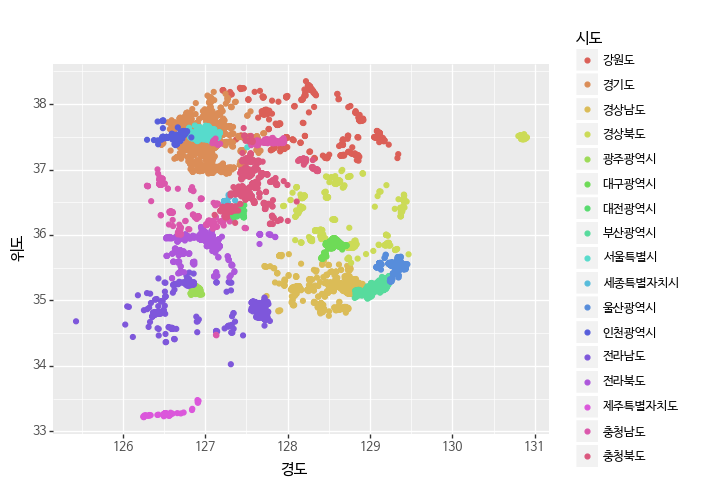

<ggplot: (162906684273)>

In [103]:
# 지역별 공원현황 지도

(ggplot(park)
 + aes(x='경도', y='위도', color='시도')
 + geom_point()
 + theme(text=element_text(family='NanumBarunGothic'))
 + scale_fill_gradient(low = 'blue', high = 'green')
)

In [105]:
# 시도별로 합계 데이터를 출력

park_do = pd.DataFrame(park['시도'].value_counts())
park_do_normalize = pd.DataFrame(park['시도'].value_counts(normalize=True))
park_sido = park_do.merge(park_do_normalize, left_index=True, right_index=True).reset_index()
park_sido.head()

,index,시도_x,시도_y
0,경기도,3396,0.275024
1,서울특별시,1098,0.088921
2,전라북도,991,0.080256
3,충청북도,904,0.073210
4,경상남도,878,0.071105


In [111]:
# 특정 type의 일부 공원만 보기

park_type = r'.*((역사|문화)공원).*'
park_type_result = park.loc[park['공원구분'].str.match(park_type)]
park_type_result.head()

,관리번호,공원명,공원구분,소재지도로명주소,소재지지번주소,위도,경도,공원면적,관리기관명,전화번호,데이터기준일자,시도,구군,지역,공원면적그래프용
42,27170-00037,서대구1공원,역사공원,대구광역시 서구 평리동 1341-10,대구광역시 서구 평리동 1341-10,35.868921,128.557541,1967.0,대구광역시 서구청,053-663-2866,2018-02-20,대구광역시,서구,대구광역시,0.1967
143,31110-30001,태화루공원,역사공원,울산광역시 중구 태화로 300 (태화동),울산광역시 중구 태화동 91-2,35.553538,129.307445,10059.0,울산광역시 중구청,052-290-4420,2018-02-20,울산광역시,중구,울산광역시,1.0059
144,31110-30002,북정공원,역사공원,울산광역시 중구 북정동 1-3,울산광역시 중구 북정동 1-3,35.557697,129.320664,36047.0,울산광역시 중구청,052-290-4420,2018-02-20,울산광역시,중구,울산광역시,3.6047
145,31110-30004,다운역사공원,역사공원,울산광역시 중구 다운동 산148,울산광역시 중구 다운동 산148,35.562661,129.263942,185100.0,울산광역시 중구청,052-290-4420,2018-02-20,울산광역시,중구,울산광역시,18.5100
162,31110-30003,98공원,역사공원,울산광역시 중구 기상대길 4-1 (북정동),울산광역시 중구 북정동 324-9,35.559229,129.319816,36879.0,울산광역시 중구청,052-290-4420,2018-02-20,울산광역시,중구,울산광역시,3.6879


In [113]:
# 한글 폰트 정보 소환!

import matplotlib.font_manager as fm
fontpath = 'C:\\WINDOWS\\Fonts\\NanumGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)

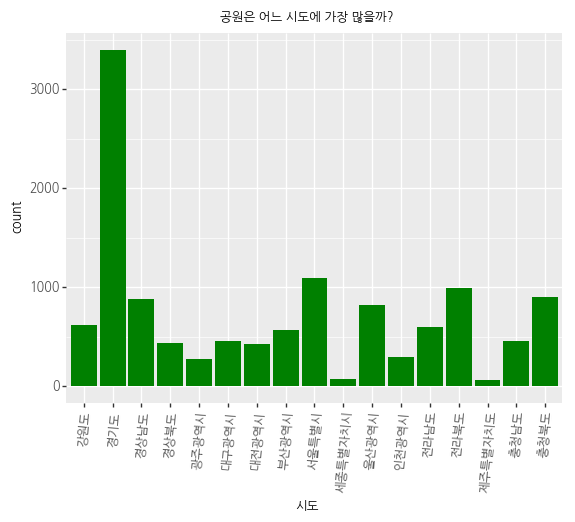

<ggplot: (162906178806)>

In [115]:
# 공원은 어느 시도에 가장 많을까?

(ggplot(park)
 + aes('시도')
 + geom_bar(fill='green')
 + ggtitle('공원은 어느 시도에 가장 많을까?')
 + theme(text=element_text(fontproperties=font),
        axis_text_x=element_text(rotation=85))
)

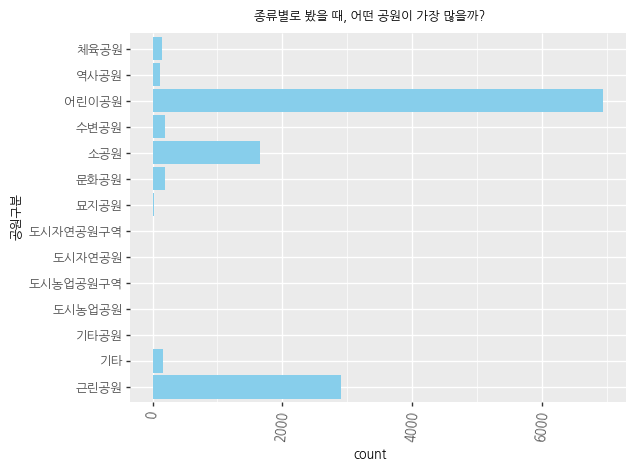

<ggplot: (-9223371873946307061)>

In [119]:
# 종류별로 봤을 때, 어떤 공원이 가장 많을까?

(ggplot(park)
 + aes('공원구분')
 + geom_bar(fill='skyblue')
 + ggtitle('종류별로 봤을 때, 어떤 공원이 가장 많을까?')
 + coord_flip()
 + theme(text=element_text(fontproperties=font),
        axis_text_x=element_text(rotation=85))
)

In [121]:
# Folium 소환!

import folium

In [123]:
# Folium 으로 지도상에 공원 위치를 뿌려보자.

map = folium.Map(location=[park['위도'].mean(), park['경도'].mean()], zoom_start=5)

for n in park.index:
    
    # 팝업에 들어갈 텍스트 지정
    popup_name = park['공원명'][n] + ' - ' + park['공원구분'][n]
    
    # 아이콘 색상 설정
    if park['공원구분'][n] == '어린이공원':
        icon_color = 'green'
    elif park['공원구분'][n] == '근린공원':
        icon_color = 'red'
    elif park['공원구분'][n] == '소공원':
        icon_color = 'blue'
    else:
        icon_color = 'black'
        
    folium.Marker([park['위도'][n], park['경도'][n]],
                   popup=popup_name,
                   icon=folium.Icon(color=icon_color)).add_to(map)
    
map